In [80]:
import pandas as pd
import numpy as np
import json
import re
from llms import gemini
from llms import chatGPT
from sklearn.metrics.pairwise import cosine_similarity
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D  # for 3D plotting
import plotly.express as px
from sklearn.manifold import TSNE
from reportlab.pdfgen import canvas
from reportlab.lib.pagesizes import letter
from reportlab.lib.utils import ImageReader
import plotly.io as pio


df = pd.read_csv("../output/bls_df.csv",index_col=0)
tsne = pd.read_csv("../output/tsne.csv",index_col=0)
df = pd.concat([df,tsne],axis=1)

In [82]:
list(df.columns)

['organization name',
 'number',
 'Example',
 'example_task_embedding',
 'founded date',
 'website',
 'description_all',
 'industries_parsed',
 'generated_description',
 'parsed_description',
 'Tasks/Jobs',
 'Industry',
 'Customers',
 'generated_description_conf_interval',
 'parsed_description_conf_interval',
 'organization_name',
 'example',
 'situation_conf_interval',
 'situation_conf_interval_reasoning',
 'job',
 'onet_title',
 'onet_task',
 'example_job_title',
 'task_similarity',
 'job_title_similarity',
 'onet_weight',
 'Major Group',
 'Minor Group',
 'Broad Group',
 'Detailed Occupation',
 'Title',
 'Major Group Name',
 'Minor Group Name',
 'Broad Group Name',
 'H_MEDIAN_US',
 'A_MEDIAN_US',
 'TOT_EMP_US',
 'Task',
 'onet_task_embedding',
 'onet_title_embedding',
 'Task ID',
 'example_task_embedding_tsne1',
 'example_task_embedding_tsne2',
 'onet_task_embedding_tsne1',
 'onet_task_embedding_tsne2',
 'onet_title_embedding_tsne1',
 'onet_title_embedding_tsne2']

In [39]:
def parse_bls(wage_employment,type):
    wage_employment = wage_employment[wage_employment.O_GROUP == "detailed"]
    wage_employment = wage_employment.rename({"OCC_CODE": "Detailed Occupation"}, axis=1)
    wage_employment = wage_employment.replace("#", np.nan).replace(r"\*+", np.nan, regex=True).replace(",", "", regex=True)
    wage_employment[["H_MEDIAN", "A_MEDIAN","TOT_EMP"]] = wage_employment[["H_MEDIAN", "A_MEDIAN","TOT_EMP"]].astype("float")
    wage_employment["H_MEDIAN"] = wage_employment["H_MEDIAN"].round(0)
    wage_employment = wage_employment[["AREA","Detailed Occupation","H_MEDIAN","A_MEDIAN","TOT_EMP"]]
    wage_employment.columns = ["AREA","Detailed Occupation","H_MEDIAN_"+type,"A_MEDIAN_"+type,"TOT_EMP_"+type, 'JOBS_1000_'+type]
    return wage_employment


nonmetro = pd.read_csv("../input/wage_employment2022/non-metro.csv")
metro = pd.read_csv("../input/wage_employment2022/metro.csv")
nonmetro = parse_bls(nonmetro,"RURAL")
metro = parse_bls(metro,"METRO")


In [79]:
nonmetro = pd.read_csv("../input/wage_employment2022/non-metro.csv")
nonmetro.columns

Index(['AREA', 'AREA_TITLE', 'AREA_TYPE', 'PRIM_STATE', 'NAICS', 'NAICS_TITLE',
       'I_GROUP', 'OWN_CODE', 'OCC_CODE', 'OCC_TITLE', 'O_GROUP', 'TOT_EMP',
       'EMP_PRSE', 'JOBS_1000', 'LOC_QUOTIENT', 'PCT_TOTAL', 'PCT_RPT',
       'H_MEAN', 'A_MEAN', 'MEAN_PRSE', 'H_PCT10', 'H_PCT25', 'H_MEDIAN',
       'H_PCT75', 'H_PCT90', 'A_PCT10', 'A_PCT25', 'A_MEDIAN', 'A_PCT75',
       'A_PCT90', 'ANNUAL', 'HOURLY'],
      dtype='object')

In [41]:
metro_grouped = metro.groupby("Detailed Occupation").aggregate({"H_MEDIAN_METRO":"mean","TOT_EMP_METRO":"sum","A_MEDIAN_METRO":"mean"},axis=1).reset_index()
nonmetro_grouped = nonmetro.groupby("Detailed Occupation").aggregate({"H_MEDIAN_RURAL":"mean","TOT_EMP_RURAL":"sum","A_MEDIAN_RURAL":"mean"},axis=1).reset_index()



In [58]:
nonmetro_grouped.TOT_EMP_RURAL.sum() 

15176050.0

In [59]:
metro_grouped.TOT_EMP_METRO.sum() 

124472550.0

In [42]:
df = df.merge(metro_grouped,on="Detailed Occupation",how="left")
df = df.merge(nonmetro_grouped,on="Detailed Occupation",how="left")

In [43]:
df.head()

,organization name,number,Example,example_task_embedding,founded date,website,description_all,industries_parsed,generated_description,parsed_description,...,onet_task_embedding_tsne1,onet_task_embedding_tsne2,onet_title_embedding_tsne1,onet_title_embedding_tsne2,H_MEDIAN_METRO,TOT_EMP_METRO,A_MEDIAN_METRO,H_MEDIAN_RURAL,TOT_EMP_RURAL,A_MEDIAN_RURAL
0,Pika,1,A social media manager uses Pika to quickly ge...,"[-0.02056259848177433, 0.0018024604069069028, ...",2023-01-01,pika.art,Pika is a startup that develops an AI-powered ...,"['Generative AI', 'Graphic Design', 'Video']",Pika is an AI-powered platform that transforms...,"Tasks/Jobs: Video creation, Video editing, Ima...",...,9.666184,5.294136,-21.525679,14.306646,26.162500,26410.0,54471.625000,35.000000,40.0,72620.000000
1,Pika,1,A social media manager uses Pika to quickly ge...,"[-0.02056259848177433, 0.0018024604069069028, ...",2023-01-01,pika.art,Pika is a startup that develops an AI-powered ...,"['Generative AI', 'Graphic Design', 'Video']",Pika is an AI-powered platform that transforms...,"Tasks/Jobs: Video creation, Video editing, Ima...",...,11.681919,2.647267,-21.525679,14.306646,26.162500,26410.0,54471.625000,35.000000,40.0,72620.000000
2,Sierra,1,A customer service representative uses Sierra'...,"[-0.010827294550836086, -0.031098157167434692,...",2023-01-01,sierra.ai,Sierra is an AI startup that tackles essential...,"['Enterprise Software', 'SaaS']",Sierra is an AI company that develops conversa...,"Tasks/Jobs: Customer service, Issue resolution...",...,-16.959490,20.195370,-1.536237,29.904528,17.258228,2510780.0,35862.126582,16.544118,198700.0,34425.514706
3,Essential AI,1,A marketing team uses Essential AI to generate...,"[0.002181823132559657, -0.020050395280122757, ...",2023-01-01,www.essential.ai,Essential AI creates AI solutions that enhance...,"['Information Technology', 'Software']",Essential AI develops and deploys AI solutions...,"Tasks/Jobs: Content generation, Data analysis,...",...,15.897010,-0.473586,23.966015,-8.884567,28.738028,237810.0,59782.873239,25.595238,15210.0,53274.841270
4,Essential AI,1,A marketing team uses Essential AI to generate...,"[0.002181823132559657, -0.020050395280122757, ...",2023-01-01,www.essential.ai,Essential AI creates AI solutions that enhance...,"['Information Technology', 'Software']",Essential AI develops and deploys AI solutions...,"Tasks/Jobs: Content generation, Data analysis,...",...,14.990998,2.202194,23.966015,-8.884567,28.738028,237810.0,59782.873239,25.595238,15210.0,53274.841270


In [53]:
df_emp = df.groupby("Detailed Occupation").aggregate({"TOT_EMP_RURAL":"first","TOT_EMP_METRO":"first"},axis=1).reset_index()


In [60]:
df_emp.TOT_EMP_RURAL.sum() / nonmetro_grouped.TOT_EMP_RURAL.sum() 

0.41590466557503436

In [61]:
df_emp.TOT_EMP_METRO.sum() / metro_grouped.TOT_EMP_METRO.sum() 

0.4757195060276342

In [73]:
df

,organization name,number,Example,example_task_embedding,founded date,website,description_all,industries_parsed,generated_description,parsed_description,...,onet_task_embedding_tsne1,onet_task_embedding_tsne2,onet_title_embedding_tsne1,onet_title_embedding_tsne2,H_MEDIAN_METRO,TOT_EMP_METRO,A_MEDIAN_METRO,H_MEDIAN_RURAL,TOT_EMP_RURAL,A_MEDIAN_RURAL
0,Pika,1,A social media manager uses Pika to quickly ge...,"[-0.02056259848177433, 0.0018024604069069028, ...",2023-01-01,pika.art,Pika is a startup that develops an AI-powered ...,"['Generative AI', 'Graphic Design', 'Video']",Pika is an AI-powered platform that transforms...,"Tasks/Jobs: Video creation, Video editing, Ima...",...,9.666184,5.294136,-21.525679,14.306646,26.162500,26410.0,54471.625000,35.000000,40.0,72620.000000
1,Pika,1,A social media manager uses Pika to quickly ge...,"[-0.02056259848177433, 0.0018024604069069028, ...",2023-01-01,pika.art,Pika is a startup that develops an AI-powered ...,"['Generative AI', 'Graphic Design', 'Video']",Pika is an AI-powered platform that transforms...,"Tasks/Jobs: Video creation, Video editing, Ima...",...,11.681919,2.647267,-21.525679,14.306646,26.162500,26410.0,54471.625000,35.000000,40.0,72620.000000
2,Sierra,1,A customer service representative uses Sierra'...,"[-0.010827294550836086, -0.031098157167434692,...",2023-01-01,sierra.ai,Sierra is an AI startup that tackles essential...,"['Enterprise Software', 'SaaS']",Sierra is an AI company that develops conversa...,"Tasks/Jobs: Customer service, Issue resolution...",...,-16.959490,20.195370,-1.536237,29.904528,17.258228,2510780.0,35862.126582,16.544118,198700.0,34425.514706
3,Essential AI,1,A marketing team uses Essential AI to generate...,"[0.002181823132559657, -0.020050395280122757, ...",2023-01-01,www.essential.ai,Essential AI creates AI solutions that enhance...,"['Information Technology', 'Software']",Essential AI develops and deploys AI solutions...,"Tasks/Jobs: Content generation, Data analysis,...",...,15.897010,-0.473586,23.966015,-8.884567,28.738028,237810.0,59782.873239,25.595238,15210.0,53274.841270
4,Essential AI,1,A marketing team uses Essential AI to generate...,"[0.002181823132559657, -0.020050395280122757, ...",2023-01-01,www.essential.ai,Essential AI creates AI solutions that enhance...,"['Information Technology', 'Software']",Essential AI develops and deploys AI solutions...,"Tasks/Jobs: Content generation, Data analysis,...",...,14.990998,2.202194,23.966015,-8.884567,28.738028,237810.0,59782.873239,25.595238,15210.0,53274.841270
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4316,Cpen AI,1,"A user subscribes to Cpen AI's newsletter, whi...","[-0.00562838651239872, -0.0370476096868515, -0...",2024-04-22,cpen.ai/,"Artificial Intelligence News, Trending AI Tool...",['Generative AI'],Cpen AI is a platform that provides news and i...,"Tasks/Jobs: Content curation, News aggregation...",...,19.474150,9.421347,2.160674,7.516479,24.123894,32660.0,50162.212389,16.369565,2590.0,33946.739130
4317,Cpen AI,1,"A user subscribes to Cpen AI's newsletter, whi...","[-0.00562838651239872, -0.0370476096868515, -0...",2024-04-22,cpen.ai/,"Artificial Intelligence News, Trending AI Tool...",['Generative AI'],Cpen AI is a platform that provides news and i...,"Tasks/Jobs: Content curation, News aggregation...",...,20.516220,6.996192,2.160674,7.516479,24.123894,32660.0,50162.212389,16.369565,2590.0,33946.739130
4318,Futureheal,1,A pediatrician uses Appai to analyze a child's...,"[-0.008862820453941822, 0.005576802417635918, ...",2024-04-24,www.futureheal.com/,Futureheal Inc. revolutionizes pediatric care ...,"['Child Care', 'Consulting', 'Health Care', 'H...",Futureheal's Appai is an AI-powered diagnostic...,"Tasks/Jobs: CBC data analysis, Abdominal pain ...",...,-7.909300,-7.088924,8.224984,-21.302511,49.478149,408520.0,102874.241645,45.533333,48320.0,94720.592593
4319,Futureheal,1,A pediatrician uses Appai to analyze a child's...,"[-0.00886282045

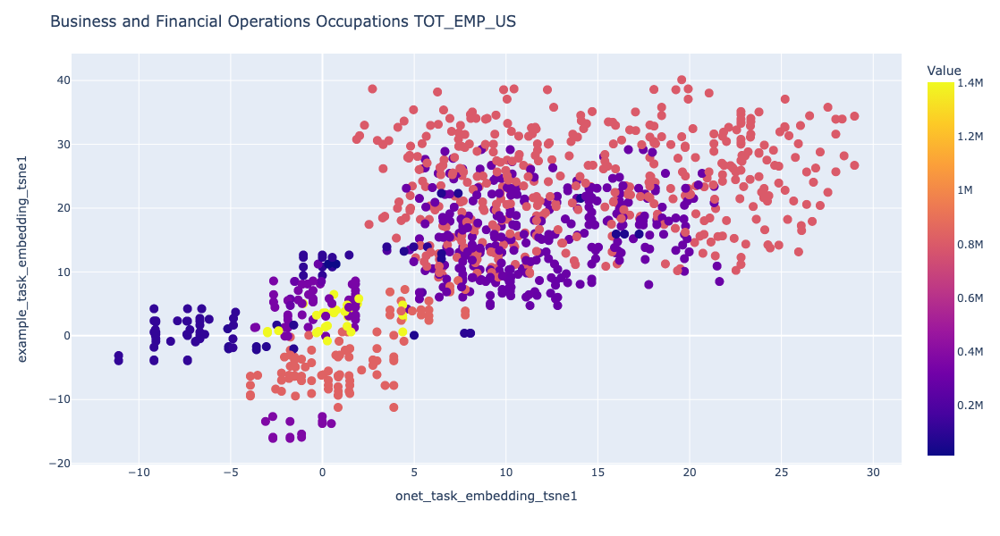

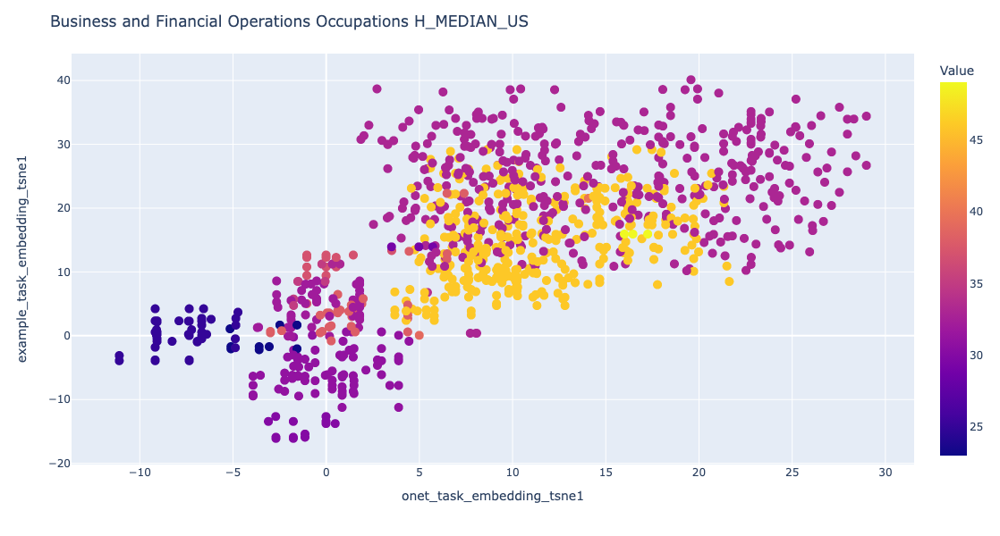

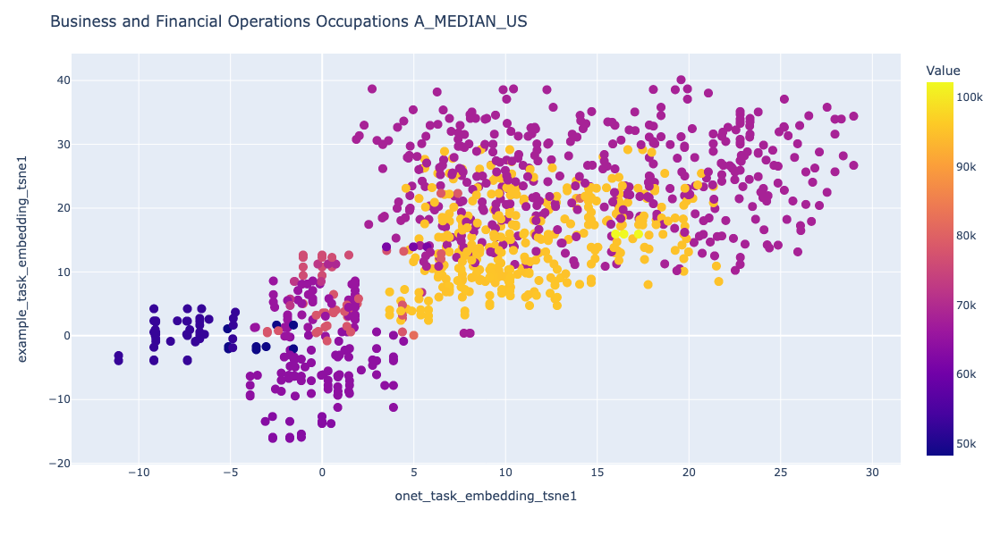

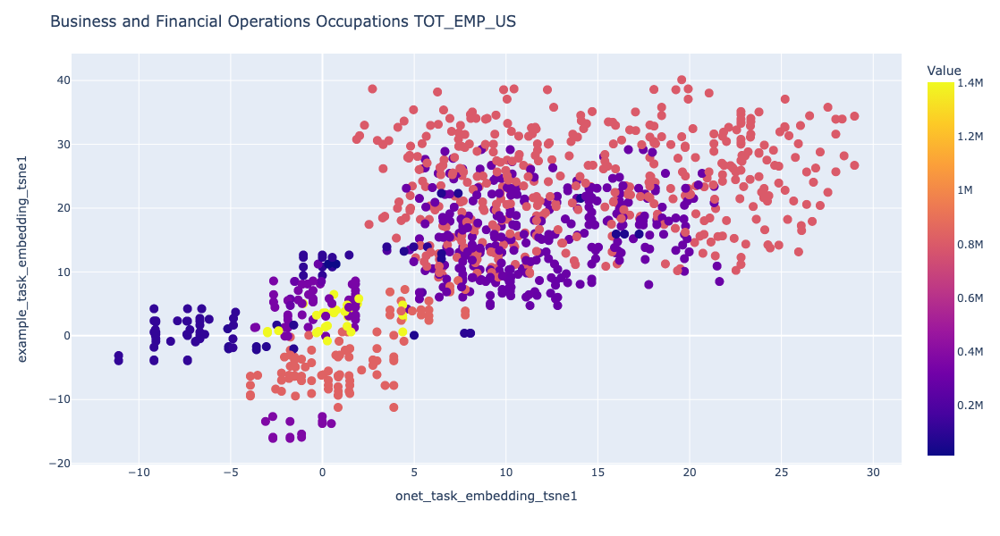

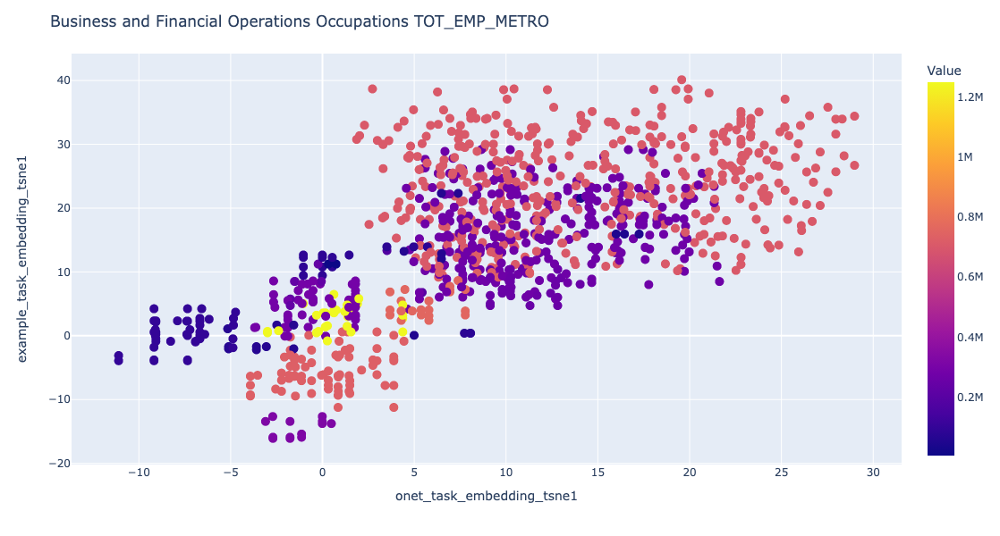

...

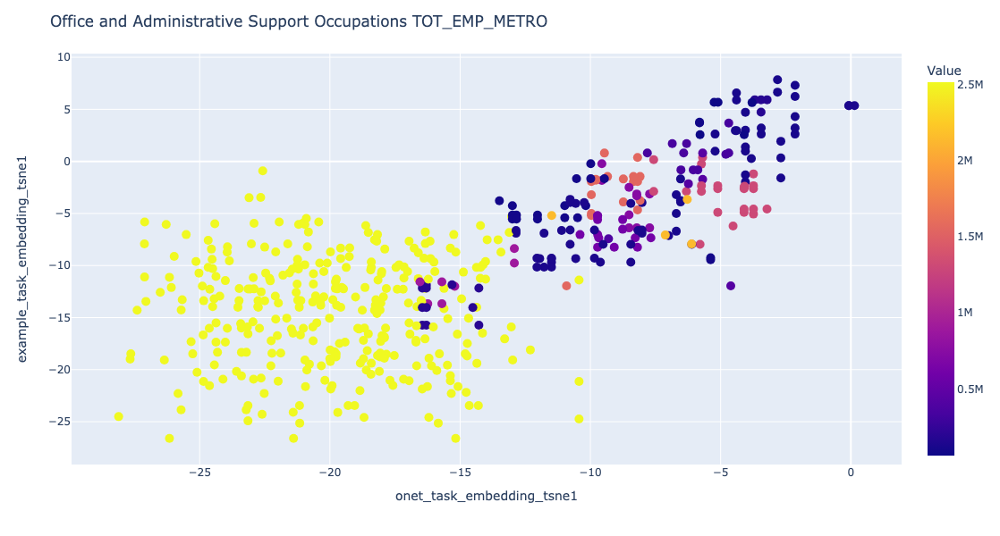

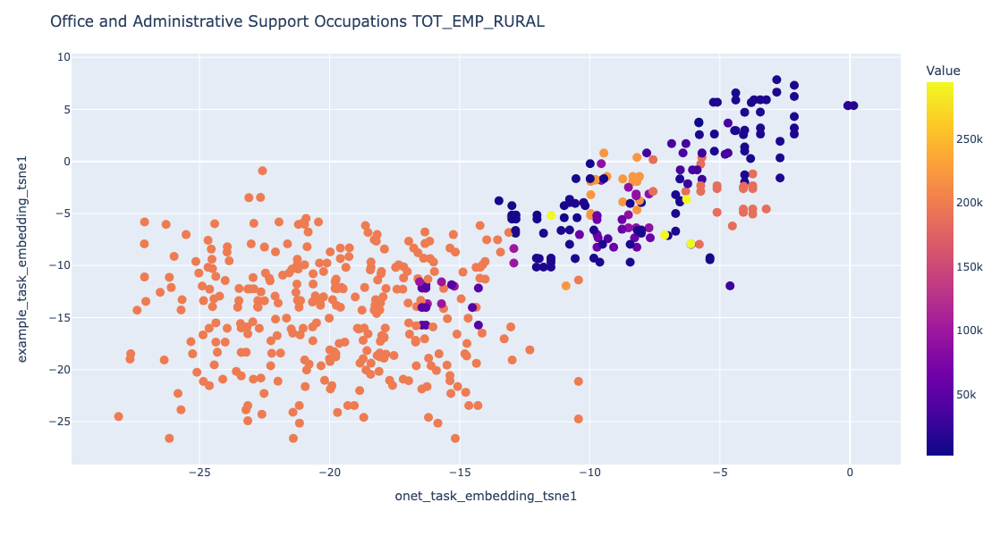

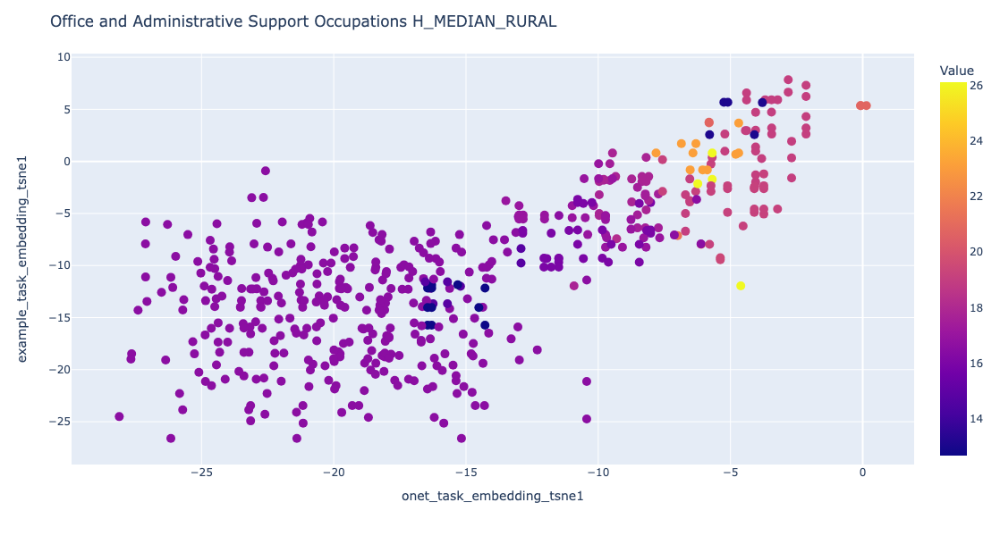

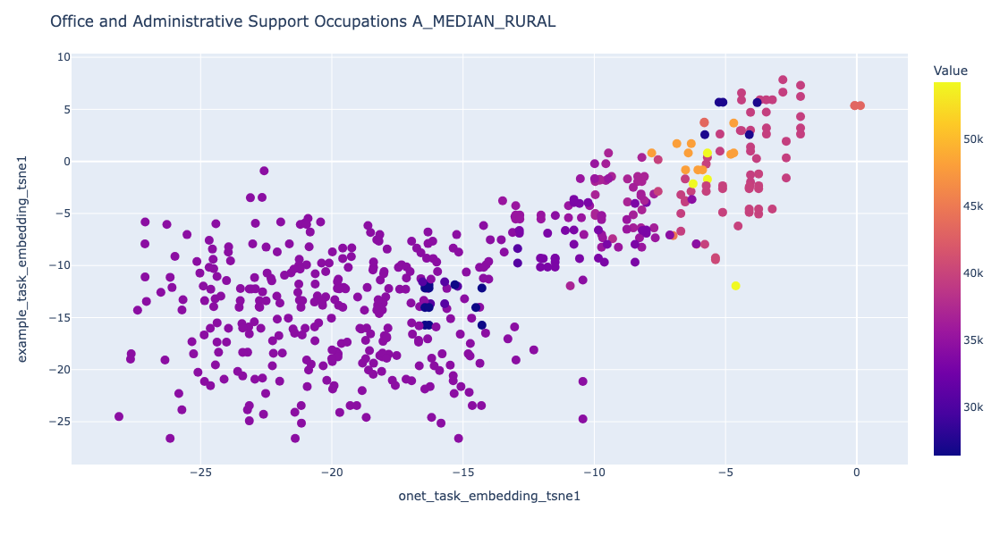

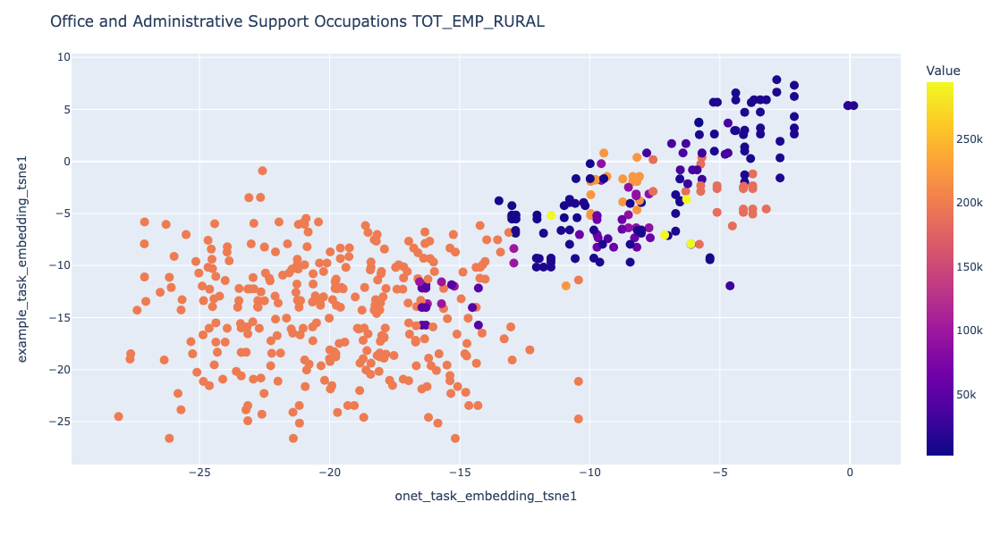

In [77]:
occ_groups = list(df.groupby("Major Group Name")["onet_title"].count().sort_values(ascending=False).index)

values = [["TOT_EMP_"+type,"H_MEDIAN_"+type,"A_MEDIAN_"+type] for type in ["US","METRO","RURAL"]]
values = [item for sublist in values for item in sublist]
values = ["JOBS_1000_"+type for type in ["US","METRO","RURAL"]]

for occ_group in occ_groups[:4]:
    for value in values:
        graph_df = df[df["Major Group Name"] == occ_group]
        graph_df.head()
        
        # Plot using Plotly with clusters
        fig = px.scatter(graph_df, x='onet_task_embedding_tsne1', y='example_task_embedding_tsne1',
                         color=value,
                         hover_data=['onet_task','job'],
                         labels={value: 'Value'})
        fig.update_traces(marker_size=10)                  
        
        fig.update_layout(
            title=f"{occ_group} {value}", 
            hovermode='closest',
            width=1000,  # Set the width of the figure
            height=600,  # Set the height of the figure
            legend=dict(font=dict(size=5)),
        )
        fig.show()

In [45]:
df[df.TOT_EMP_METRO > df.TOT_EMP_RURAL]

,organization name,number,Example,example_task_embedding,founded date,website,description_all,industries_parsed,generated_description,parsed_description,...,onet_task_embedding_tsne1,onet_task_embedding_tsne2,onet_title_embedding_tsne1,onet_title_embedding_tsne2,H_MEDIAN_METRO,TOT_EMP_METRO,A_MEDIAN_METRO,H_MEDIAN_RURAL,TOT_EMP_RURAL,A_MEDIAN_RURAL
0,Pika,1,A social media manager uses Pika to quickly ge...,"[-0.02056259848177433, 0.0018024604069069028, ...",2023-01-01,pika.art,Pika is a startup that develops an AI-powered ...,"['Generative AI', 'Graphic Design', 'Video']",Pika is an AI-powered platform that transforms...,"Tasks/Jobs: Video creation, Video editing, Ima...",...,9.666184,5.294136,-21.525679,14.306646,26.162500,26410.0,54471.625000,35.000000,40.0,72620.000000
1,Pika,1,A social media manager uses Pika to quickly ge...,"[-0.02056259848177433, 0.0018024604069069028, ...",2023-01-01,pika.art,Pika is a startup that develops an AI-powered ...,"['Generative AI', 'Graphic Design', 'Video']",Pika is an AI-powered platform that transforms...,"Tasks/Jobs: Video creation, Video editing, Ima...",...,11.681919,2.647267,-21.525679,14.306646,26.162500,26410.0,54471.625000,35.000000,40.0,72620.000000
2,Sierra,1,A customer service representative uses Sierra'...,"[-0.010827294550836086, -0.031098157167434692,...",2023-01-01,sierra.ai,Sierra is an AI startup that tackles essential...,"['Enterprise Software', 'SaaS']",Sierra is an AI company that develops conversa...,"Tasks/Jobs: Customer service, Issue resolution...",...,-16.959490,20.195370,-1.536237,29.904528,17.258228,2510780.0,35862.126582,16.544118,198700.0,34425.514706
3,Essential AI,1,A marketing team uses Essential AI to generate...,"[0.002181823132559657, -0.020050395280122757, ...",2023-01-01,www.essential.ai,Essential AI creates AI solutions that enhance...,"['Information Technology', 'Software']",Essential AI develops and deploys AI solutions...,"Tasks/Jobs: Content generation, Data analysis,...",...,15.897010,-0.473586,23.966015,-8.884567,28.738028,237810.0,59782.873239,25.595238,15210.0,53274.841270
4,Essential AI,1,A marketing team uses Essential AI to generate...,"[0.002181823132559657, -0.020050395280122757, ...",2023-01-01,www.essential.ai,Essential AI creates AI solutions that enhance...,"['Information Technology', 'Software']",Essential AI develops and deploys AI solutions...,"Tasks/Jobs: Content generation, Data analysis,...",...,14.990998,2.202194,23.966015,-8.884567,28.738028,237810.0,59782.873239,25.595238,15210.0,53274.841270
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4316,Cpen AI,1,"A user subscribes to Cpen AI's newsletter, whi...","[-0.00562838651239872, -0.0370476096868515, -0...",2024-04-22,cpen.ai/,"Artificial Intelligence News, Trending AI Tool...",['Generative AI'],Cpen AI is a platform that provides news and i...,"Tasks/Jobs: Content curation, News aggregation...",...,19.474150,9.421347,2.160674,7.516479,24.123894,32660.0,50162.212389,16.369565,2590.0,33946.739130
4317,Cpen AI,1,"A user subscribes to Cpen AI's newsletter, whi...","[-0.00562838651239872, -0.0370476096868515, -0...",2024-04-22,cpen.ai/,"Artificial Intelligence News, Trending AI Tool...",['Generative AI'],Cpen AI is a platform that provides news and i...,"Tasks/Jobs: Content curation, News aggregation...",...,20.516220,6.996192,2.160674,7.516479,24.123894,32660.0,50162.212389,16.369565,2590.0,33946.739130
4318,Futureheal,1,A pediatrician uses Appai to analyze a child's...,"[-0.008862820453941822, 0.005576802417635918, ...",2024-04-24,www.futureheal.com/,Futureheal Inc. revolutionizes pediatric care ...,"['Child Care', 'Consulting', 'Health Care', 'H...",Futureheal's Appai is an AI-powered diagnostic...,"Tasks/Jobs: CBC data analysis, Abdominal pain ...",...,-7.909300,-7.088924,8.224984,-21.302511,49.478149,408520.0,102874.241645,45.533333,48320.0,94720.592593
4319,Futureheal,1,A pediatrician uses Appai to analyze a child's...,"[-0.00886282045